In [8]:
from tqdm import tqdm
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

In [ ]:
M01_DC_train = pd.read_csv("../phm_etching_01M01-02/01_M01_DC_train.csv", encoding="utf8")

In [2140]:
# https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.subplot.html
# https://matplotlib.org/stable/gallery/subplots_axes_and_figures/subplots_demo.html
# https://stackoverflow.com/questions/14770735/how-do-i-change-the-figure-size-with-subplots

fig, axs = plt.subplots(17, 1, figsize=(150,50))

axs[0].plot(M01_DC_train.loc[:, 'IONGAUGEPRESSURE'])
axs[0].set_title("IONGAUGEPRESSURE")
axs[1].plot(M01_DC_train.loc[:, 'ETCHBEAMVOLTAGE'])
axs[1].set_title('ETCHBEAMVOLTAGE')
axs[2].plot(M01_DC_train.loc[:, 'ETCHBEAMCURRENT'])
axs[2].set_title('ETCHBEAMCURRENT')
axs[3].plot(M01_DC_train.loc[:, 'ETCHSUPPRESSORVOLTAGE'])
axs[3].set_title('ETCHSUPPRESSORVOLTAGE')
axs[4].plot(M01_DC_train.loc[:, 'ETCHSUPPRESSORCURRENT'])
axs[4].set_title('ETCHSUPPRESSORCURRENT')
axs[5].plot(M01_DC_train.loc[:, 'FLOWCOOLFLOWRATE'])
axs[5].set_title('FLOWCOOLFLOWRATE')
axs[6].plot(M01_DC_train.loc[:, 'FLOWCOOLPRESSURE'])
axs[6].set_title('FLOWCOOLPRESSURE')
axs[7].plot(M01_DC_train.loc[:, 'ETCHGASCHANNEL1READBACK'])
axs[7].set_title('ETCHGASCHANNEL1READBACK')
axs[8].plot(M01_DC_train.loc[:, 'ETCHPBNGASREADBACK'])
axs[8].set_title('ETCHPBNGASREADBACK')
axs[9].plot(M01_DC_train.loc[:, 'FIXTURETILTANGLE'])
axs[9].set_title('FIXTURETILTANGLE')
axs[10].plot(M01_DC_train.loc[:, 'ROTATIONSPEED'])
axs[10].set_title('ROTATIONSPEED')
axs[11].plot(M01_DC_train.loc[:, 'ACTUALROTATIONANGLE'])
axs[11].set_title('ACTUALROTATIONANGLE')
axs[12].plot(M01_DC_train.loc[:, 'FIXTURESHUTTERPOSITION'])
axs[12].set_title('FIXTURESHUTTERPOSITION')
axs[13].plot(M01_DC_train.loc[:, 'ETCHSOURCEUSAGE'])
axs[13].set_title('ETCHSOURCEUSAGE')
axs[14].plot(M01_DC_train.loc[:, 'ETCHAUXSOURCETIMER'])
axs[14].set_title('ETCHAUXSOURCETIMER')
axs[15].plot(M01_DC_train.loc[:, 'ETCHAUX2SOURCETIMER'])
axs[15].set_title('ETCHAUX2SOURCETIMER')
axs[16].plot(M01_DC_train.loc[:, 'ACTUALSTEPDURATION'])
axs[16].set_title('ACTUALSTEPDURATION')

plt.savefig('./Overview.svg', format='svg', bbox_inches="tight")

Index(['time', 'Tool', 'stage', 'Lot', 'runnum', 'recipe', 'recipe_step',
       'IONGAUGEPRESSURE', 'ETCHBEAMVOLTAGE', 'ETCHBEAMCURRENT',
       'ETCHSUPPRESSORVOLTAGE', 'ETCHSUPPRESSORCURRENT', 'FLOWCOOLFLOWRATE',
       'FLOWCOOLPRESSURE', 'ETCHGASCHANNEL1READBACK', 'ETCHPBNGASREADBACK',
       'FIXTURETILTANGLE', 'ROTATIONSPEED', 'ACTUALROTATIONANGLE',
       'FIXTURESHUTTERPOSITION', 'ETCHSOURCEUSAGE', 'ETCHAUXSOURCETIMER',
       'ETCHAUX2SOURCETIMER', 'ACTUALSTEPDURATION'],
      dtype='object')
Index(['time', 'TTF_FlowCool Pressure Dropped Below Limit',
       'TTF_Flowcool Pressure Too High Check Flowcool Pump',
       'TTF_Flowcool leak'],
      dtype='object')


c:\users\user\anaconda3\envs\monpa\lib\site-packages\matplotlib\textpath.py:65: RuntimeWarning: Glyph 8722 missing from current font.
  font.set_text(s, 0.0, flags=LOAD_NO_HINTING)


# Segmenting Sensor Data before Failure

In [4]:
from tqdm import tqdm
import numpy as np
import pandas as pd

In [2]:
M01_DC_train = pd.read_csv("../phm_etching_01M01-02/01_M01_DC_train.csv", encoding="utf8")

In [14]:
# parameters
SEGMENTATION_RANGE = 500000

faultTime_FlowcoolPressureTooHighCheckFlowcoolPump = [12633978, 
                                                      18541016, 26098946, 39525730, 40564654]
faultTime_FlowCoolPressureDroppedBelowLimit = [6533184, 8286500, 8627086, 8697338, 8971400, 12828066,
                   14026692, 15827488, 31185146, 40082846, 20174938]


file_num = 0
for faultTimeIndex, faultTime in enumerate(tqdm(faultTime_FlowcoolPressureTooHighCheckFlowcoolPump + \
faultTime_FlowCoolPressureDroppedBelowLimit)):
    
    # reset index when dealing with second list
    if faultTimeIndex == len(faultTime_FlowcoolPressureTooHighCheckFlowcoolPump):
        file_num = 0
        
    timeIndex = M01_DC_train.loc[:, "time"].tolist().index(faultTime)

    starting_point = (timeIndex - SEGMENTATION_RANGE) if (timeIndex - SEGMENTATION_RANGE) > 0 else 0
    data_temp = M01_DC_train.iloc[starting_point: timeIndex + 1, :]
#     print(faultTime, timeIndex, (timeIndex - SEGMENTATION_RANGE))
    print(len(data_temp))
    
    # export data
    if faultTime in faultTime_FlowcoolPressureTooHighCheckFlowcoolPump:
        data_temp.to_csv("../phm_etching_01M01-02/M01_DC_train_FlowcoolPressureTooHighCheckFlowcoolPump_" + \
                         str(file_num) + ".csv", index=None, encoding="utf8")
        file_num += 1
    else:
        data_temp.to_csv("../phm_etching_01M01-02/M01_DC_train_FlowCoolPressureDroppedBelowLimit_" + \
                         str(file_num) + ".csv", index=None, encoding="utf8")
        file_num += 1
        

  0%|          | 0/16 [00:00<?, ?it/s]

500001


  6%|▋         | 1/16 [00:08<02:07,  8.48s/it]

500001


 12%|█▎        | 2/16 [00:16<01:58,  8.47s/it]

500001


 19%|█▉        | 3/16 [00:25<01:50,  8.49s/it]

500001


 25%|██▌       | 4/16 [00:33<01:41,  8.50s/it]

500001


 31%|███▏      | 5/16 [00:42<01:33,  8.50s/it]

173175


 38%|███▊      | 6/16 [00:45<01:06,  6.64s/it]

354985


 44%|████▍     | 7/16 [00:51<00:58,  6.49s/it]

377786


 50%|█████     | 8/16 [00:58<00:51,  6.50s/it]

386393


 56%|█████▋    | 9/16 [01:04<00:45,  6.55s/it]

420492


 62%|██████▎   | 10/16 [01:12<00:40,  6.75s/it]

500001


 69%|██████▉   | 11/16 [01:20<00:36,  7.29s/it]

500001


 75%|███████▌  | 12/16 [01:29<00:30,  7.67s/it]

500001


 81%|████████▏ | 13/16 [01:37<00:23,  7.92s/it]

500001


 88%|████████▊ | 14/16 [01:46<00:16,  8.09s/it]

500001


 94%|█████████▍| 15/16 [01:54<00:08,  8.23s/it]

500001


100%|██████████| 16/16 [02:03<00:00,  7.70s/it]


# Graphing faultTime Flowcool Pressure Too High Check Flowcool Pump

In [44]:
from tqdm import tqdm
import numpy as np
import os
import pandas as pd
import matplotlib.pyplot as plt

In [30]:
M01_DC_train_original = pd.read_csv("../phm_etching_01M01-02/M01_DC_train_FlowCoolPressureDroppedBelowLimit/M01_DC_train_FlowCoolPressureDroppedBelowLimit_0.csv",
                  encoding="utf8")
M01_DC_train_original.drop_duplicates(inplace=True)
M01_DC_train_ttf = pd.read_csv("../phm_etching_01M01-02/M01_DC_train_ttf_FlowCoolPressureDroppedBelowLimit/M01_DC_train_ttf_FlowCoolPressureDroppedBelowLimit_0.csv",
                  encoding="utf8")
M01_DC_train_ttf.drop_duplicates(inplace=True)

print(M01_DC_train_original.columns)
print(len(M01_DC_train_original))
print(M01_DC_train_ttf.columns)
print(len(M01_DC_train_ttf))

Index(['time', 'Tool', 'stage', 'Lot', 'runnum', 'recipe', 'recipe_step',
       'IONGAUGEPRESSURE', 'ETCHBEAMVOLTAGE', 'ETCHBEAMCURRENT',
       'ETCHSUPPRESSORVOLTAGE', 'ETCHSUPPRESSORCURRENT', 'FLOWCOOLFLOWRATE',
       'FLOWCOOLPRESSURE', 'ETCHGASCHANNEL1READBACK', 'ETCHPBNGASREADBACK',
       'FIXTURETILTANGLE', 'ROTATIONSPEED', 'ACTUALROTATIONANGLE',
       'FIXTURESHUTTERPOSITION', 'ETCHSOURCEUSAGE', 'ETCHAUXSOURCETIMER',
       'ETCHAUX2SOURCETIMER', 'ACTUALSTEPDURATION'],
      dtype='object')
173157
Index(['time', 'TTF_FlowCool Pressure Dropped Below Limit',
       'TTF_Flowcool Pressure Too High Check Flowcool Pump',
       'TTF_Flowcool leak'],
      dtype='object')
173080


In [33]:
M01_DC_train = M01_DC_train_original.merge(M01_DC_train_ttf, left_on="time", right_on="time",
                                           how="inner")
print(M01_DC_train.columns)
print(len(M01_DC_train))

# check if there's duplicated rows amd null values
# print(M01_DC_train.isnull().any())
# duplicateDFRow = M01_DC_train[M01_DC_train.duplicated()]
# print(duplicateDFRow)

Index(['time', 'Tool', 'stage', 'Lot', 'runnum', 'recipe', 'recipe_step',
       'IONGAUGEPRESSURE', 'ETCHBEAMVOLTAGE', 'ETCHBEAMCURRENT',
       'ETCHSUPPRESSORVOLTAGE', 'ETCHSUPPRESSORCURRENT', 'FLOWCOOLFLOWRATE',
       'FLOWCOOLPRESSURE', 'ETCHGASCHANNEL1READBACK', 'ETCHPBNGASREADBACK',
       'FIXTURETILTANGLE', 'ROTATIONSPEED', 'ACTUALROTATIONANGLE',
       'FIXTURESHUTTERPOSITION', 'ETCHSOURCEUSAGE', 'ETCHAUXSOURCETIMER',
       'ETCHAUX2SOURCETIMER', 'ACTUALSTEPDURATION',
       'TTF_FlowCool Pressure Dropped Below Limit',
       'TTF_Flowcool Pressure Too High Check Flowcool Pump',
       'TTF_Flowcool leak'],
      dtype='object')
173157


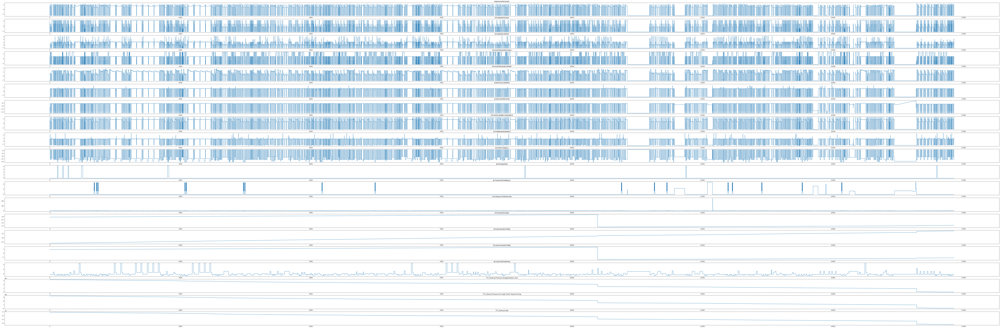

In [34]:
fig, axs = plt.subplots(20, 1, figsize=(150,50))

axs[0].plot(M01_DC_train.loc[:, 'IONGAUGEPRESSURE'])
axs[0].set_title("IONGAUGEPRESSURE")
axs[1].plot(M01_DC_train.loc[:, 'ETCHBEAMVOLTAGE'])
axs[1].set_title('ETCHBEAMVOLTAGE')
axs[2].plot(M01_DC_train.loc[:, 'ETCHBEAMCURRENT'])
axs[2].set_title('ETCHBEAMCURRENT')
axs[3].plot(M01_DC_train.loc[:, 'ETCHSUPPRESSORVOLTAGE'])
axs[3].set_title('ETCHSUPPRESSORVOLTAGE')
axs[4].plot(M01_DC_train.loc[:, 'ETCHSUPPRESSORCURRENT'])
axs[4].set_title('ETCHSUPPRESSORCURRENT')
axs[5].plot(M01_DC_train.loc[:, 'FLOWCOOLFLOWRATE'])
axs[5].set_title('FLOWCOOLFLOWRATE')
axs[6].plot(M01_DC_train.loc[:, 'FLOWCOOLPRESSURE'])
axs[6].set_title('FLOWCOOLPRESSURE')
axs[7].plot(M01_DC_train.loc[:, 'ETCHGASCHANNEL1READBACK'])
axs[7].set_title('ETCHGASCHANNEL1READBACK')
axs[8].plot(M01_DC_train.loc[:, 'ETCHPBNGASREADBACK'])
axs[8].set_title('ETCHPBNGASREADBACK')
axs[9].plot(M01_DC_train.loc[:, 'FIXTURETILTANGLE'])
axs[9].set_title('FIXTURETILTANGLE')
axs[10].plot(M01_DC_train.loc[:, 'ROTATIONSPEED'])
axs[10].set_title('ROTATIONSPEED')
axs[11].plot(M01_DC_train.loc[:, 'ACTUALROTATIONANGLE'])
axs[11].set_title('ACTUALROTATIONANGLE')
axs[12].plot(M01_DC_train.loc[:, 'FIXTURESHUTTERPOSITION'])
axs[12].set_title('FIXTURESHUTTERPOSITION')
axs[13].plot(M01_DC_train.loc[:, 'ETCHSOURCEUSAGE'])
axs[13].set_title('ETCHSOURCEUSAGE')
axs[14].plot(M01_DC_train.loc[:, 'ETCHAUXSOURCETIMER'])
axs[14].set_title('ETCHAUXSOURCETIMER')
axs[15].plot(M01_DC_train.loc[:, 'ETCHAUX2SOURCETIMER'])
axs[15].set_title('ETCHAUX2SOURCETIMER')
axs[16].plot(M01_DC_train.loc[:, 'ACTUALSTEPDURATION'])
axs[16].set_title('ACTUALSTEPDURATION')
axs[17].plot(M01_DC_train.loc[:, 'TTF_FlowCool Pressure Dropped Below Limit'])
axs[17].set_title('TTF_FlowCool Pressure Dropped Below Limit')
axs[18].plot(M01_DC_train.loc[:, 'TTF_Flowcool Pressure Too High Check Flowcool Pump'])
axs[18].set_title('TTF_Flowcool Pressure Too High Check Flowcool Pump')
axs[19].plot(M01_DC_train.loc[:, 'TTF_Flowcool leak'])
axs[19].set_title('TTF_Flowcool leak')


plt.savefig('./Graphs/M01_DC_train_FlowCoolPressureDroppedBelowLimit_0.svg', format='svg', bbox_inches="tight")

100%|██████████| 11/11 [00:37<00:00,  3.44s/it]


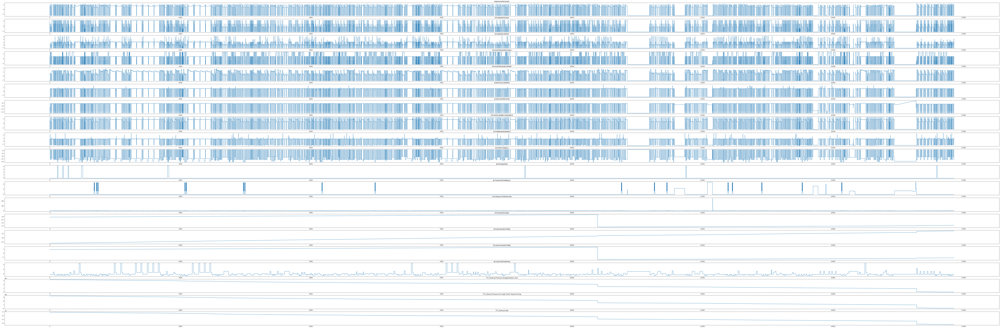

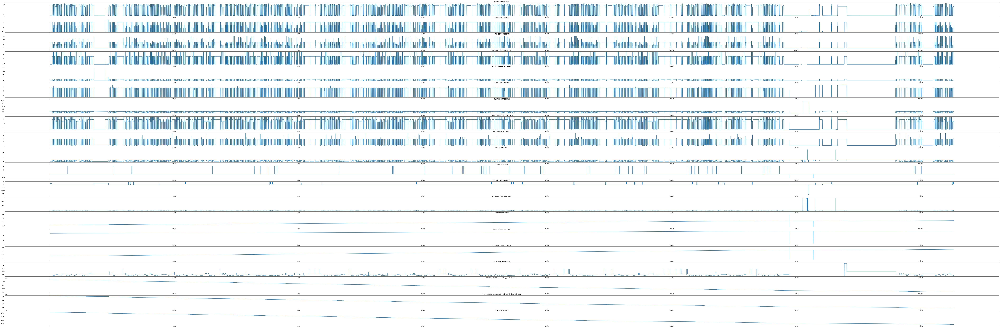

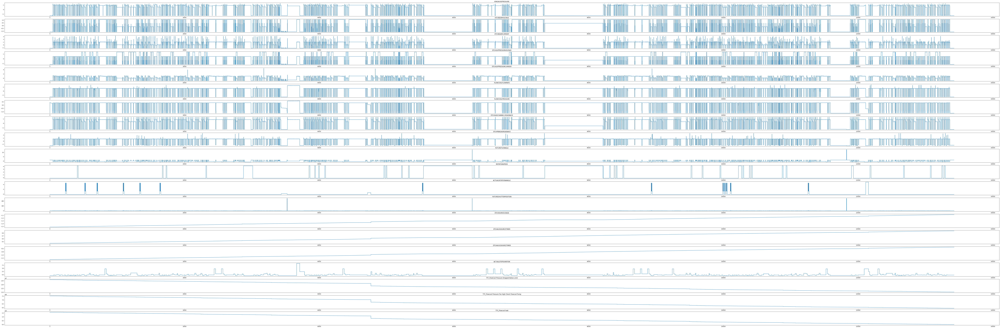

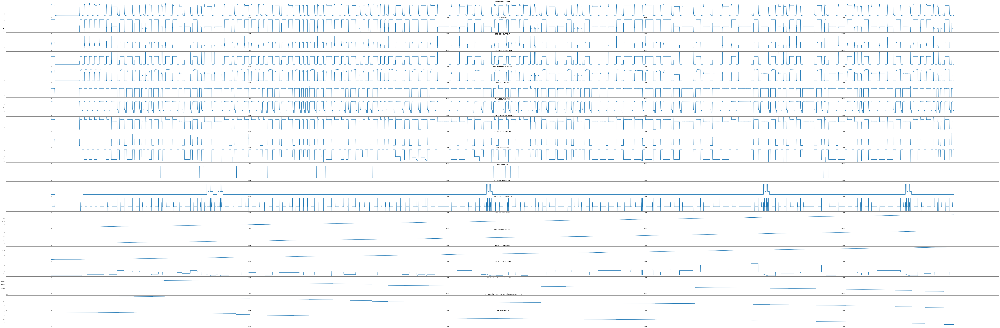

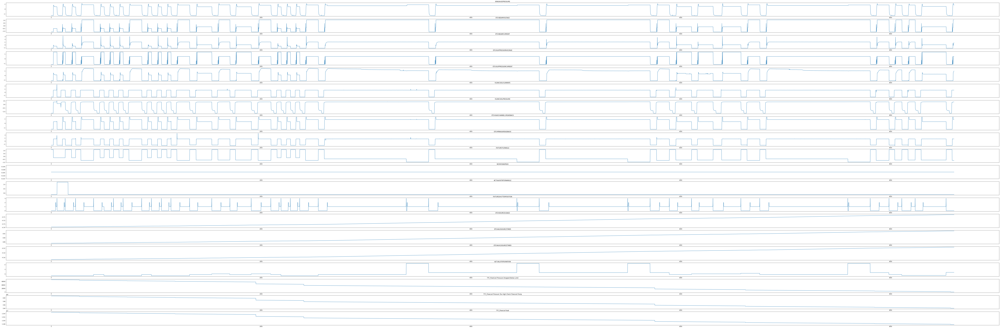

...

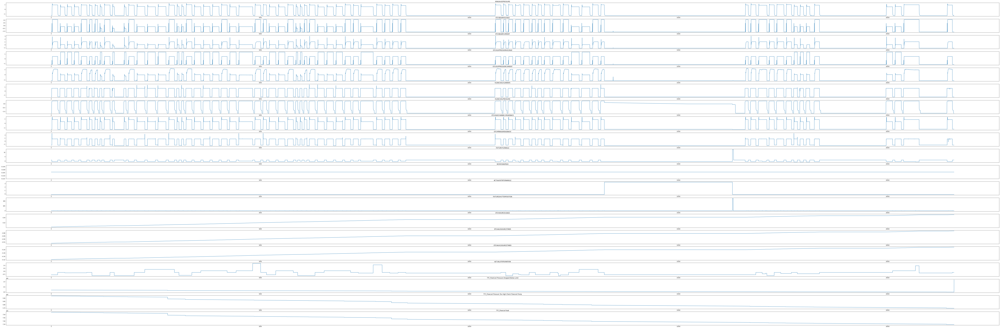

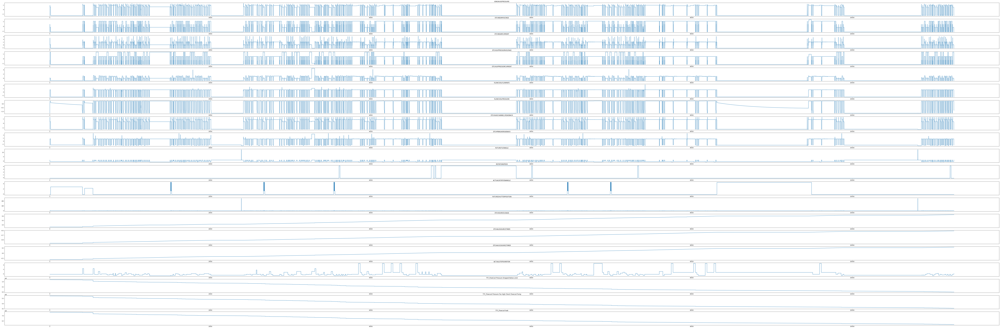

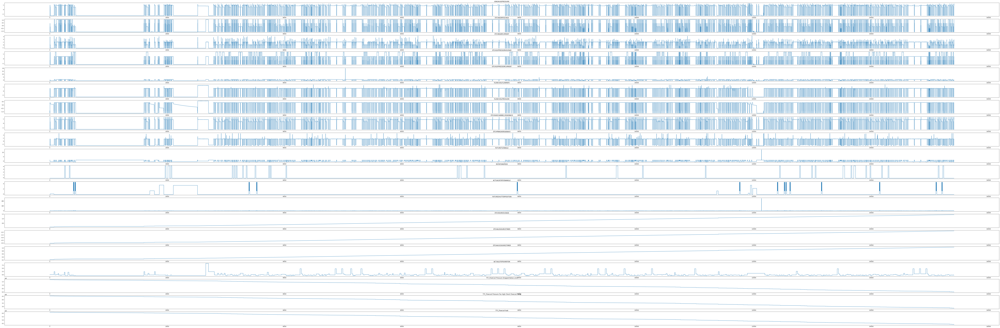

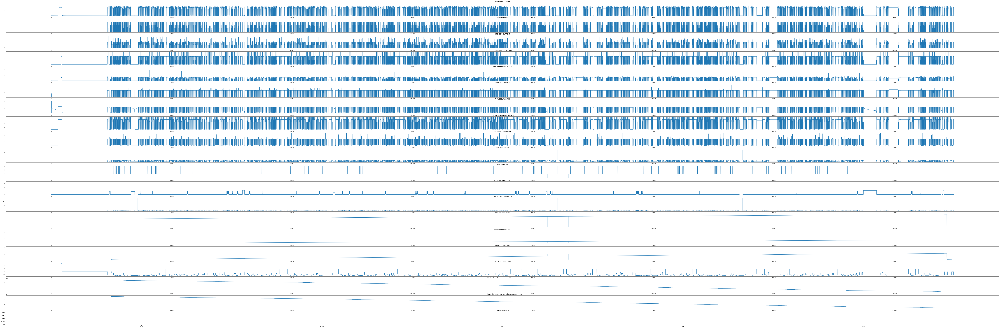

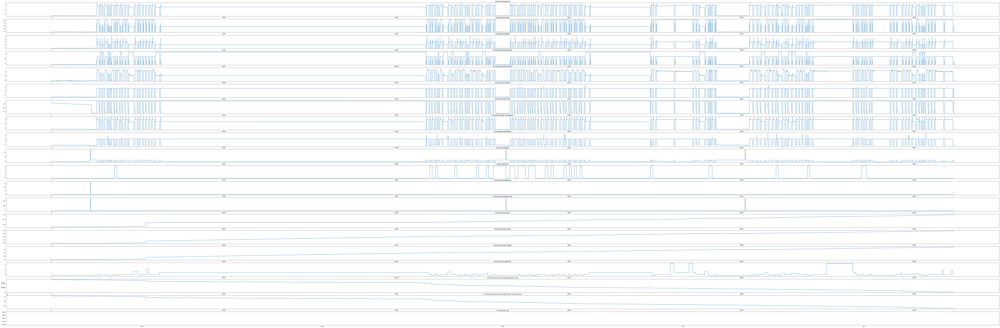

In [45]:
for fileIndex, file in enumerate(tqdm(os.listdir("../phm_etching_01M01-02/M01_DC_train_FlowCoolPressureDroppedBelowLimit/"))):
    M01_DC_train_original = pd.read_csv("../phm_etching_01M01-02/M01_DC_train_FlowCoolPressureDroppedBelowLimit/" + file,
                  encoding="utf8")
    M01_DC_train_ttf = pd.read_csv("../phm_etching_01M01-02/M01_DC_train_ttf_FlowCoolPressureDroppedBelowLimit/" +\
                                   file[:13] + "ttf" + file[12:],
                  encoding="utf8")
    
    M01_DC_train_original.drop_duplicates(inplace=True)
    M01_DC_train_ttf.drop_duplicates(inplace=True)
    M01_DC_train = M01_DC_train_original.merge(M01_DC_train_ttf, left_on="time", right_on="time",
                                           how="inner")
    
    fig, axs = plt.subplots(20, 1, figsize=(150,50))

    axs[0].plot(M01_DC_train.loc[:, 'IONGAUGEPRESSURE'])
    axs[0].set_title("IONGAUGEPRESSURE")
    axs[1].plot(M01_DC_train.loc[:, 'ETCHBEAMVOLTAGE'])
    axs[1].set_title('ETCHBEAMVOLTAGE')
    axs[2].plot(M01_DC_train.loc[:, 'ETCHBEAMCURRENT'])
    axs[2].set_title('ETCHBEAMCURRENT')
    axs[3].plot(M01_DC_train.loc[:, 'ETCHSUPPRESSORVOLTAGE'])
    axs[3].set_title('ETCHSUPPRESSORVOLTAGE')
    axs[4].plot(M01_DC_train.loc[:, 'ETCHSUPPRESSORCURRENT'])
    axs[4].set_title('ETCHSUPPRESSORCURRENT')
    axs[5].plot(M01_DC_train.loc[:, 'FLOWCOOLFLOWRATE'])
    axs[5].set_title('FLOWCOOLFLOWRATE')
    axs[6].plot(M01_DC_train.loc[:, 'FLOWCOOLPRESSURE'])
    axs[6].set_title('FLOWCOOLPRESSURE')
    axs[7].plot(M01_DC_train.loc[:, 'ETCHGASCHANNEL1READBACK'])
    axs[7].set_title('ETCHGASCHANNEL1READBACK')
    axs[8].plot(M01_DC_train.loc[:, 'ETCHPBNGASREADBACK'])
    axs[8].set_title('ETCHPBNGASREADBACK')
    axs[9].plot(M01_DC_train.loc[:, 'FIXTURETILTANGLE'])
    axs[9].set_title('FIXTURETILTANGLE')
    axs[10].plot(M01_DC_train.loc[:, 'ROTATIONSPEED'])
    axs[10].set_title('ROTATIONSPEED')
    axs[11].plot(M01_DC_train.loc[:, 'ACTUALROTATIONANGLE'])
    axs[11].set_title('ACTUALROTATIONANGLE')
    axs[12].plot(M01_DC_train.loc[:, 'FIXTURESHUTTERPOSITION'])
    axs[12].set_title('FIXTURESHUTTERPOSITION')
    axs[13].plot(M01_DC_train.loc[:, 'ETCHSOURCEUSAGE'])
    axs[13].set_title('ETCHSOURCEUSAGE')
    axs[14].plot(M01_DC_train.loc[:, 'ETCHAUXSOURCETIMER'])
    axs[14].set_title('ETCHAUXSOURCETIMER')
    axs[15].plot(M01_DC_train.loc[:, 'ETCHAUX2SOURCETIMER'])
    axs[15].set_title('ETCHAUX2SOURCETIMER')
    axs[16].plot(M01_DC_train.loc[:, 'ACTUALSTEPDURATION'])
    axs[16].set_title('ACTUALSTEPDURATION')
    axs[17].plot(M01_DC_train.loc[:, 'TTF_FlowCool Pressure Dropped Below Limit'])
    axs[17].set_title('TTF_FlowCool Pressure Dropped Below Limit')
    axs[18].plot(M01_DC_train.loc[:, 'TTF_Flowcool Pressure Too High Check Flowcool Pump'])
    axs[18].set_title('TTF_Flowcool Pressure Too High Check Flowcool Pump')
    axs[19].plot(M01_DC_train.loc[:, 'TTF_Flowcool leak'])
    axs[19].set_title('TTF_Flowcool leak')
    
    plt.savefig("./Graphs/" + file[:-4] +".svg", format='svg', bbox_inches="tight")